<a href="https://colab.research.google.com/github/arun-arunisto/OpenCVTutorial/blob/todo/FeatureMatching.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Feature Matching

Feature matching involves comparing key attributes in different images to find similarities. Feature matching is useful in many computer vision applications, including scene understanding, image stitching, object tracking, and pattern recognition.

### Brute-Force Search

Imagine you have a giant box of puzzle pieces, and you’re trying to find a specific piece that fits into your puzzle. This is similar to searching for matching features in images. Instead of having any special strategy, you decide to check every piece, one by one until you find the right one. This straightforward method is a brute-force search. The advantage of brute force is its simplicity. You don’t need any special tricks – just patience. However, it can be time-consuming, especially if there are a lot of pieces to check. In the context of feature matching, this brute force approach is akin to comparing every pixel in one image to every pixel in another to see if they match. It’s exhaustive and it might take a lot of time, especially for large images.

### Brute-Force with SIFT

Scale-invariant feature transform (SIFT) is a computer vision algorithm that **detects**, **describes**, and matches **local** **features** in images. SIFT was invented by David Lowe in 1999.

In [ ]:
#importing required packages
import cv2
import numpy as np

In [ ]:
sift = cv2.SIFT_create()

In [ ]:
#loading two images
img1 = cv2.imread("/content/drive/MyDrive/ComputerVisionTutorial/ImagesToPractise/feature_matching_roma1.jpg")
img2 = cv2.imread("/content/drive/MyDrive/ComputerVisionTutorial/ImagesToPractise/feature_matching_roma2.jpg")

In google colab we're not able to use **cv2.imshow()** method for that we need to import the alternative module for image showing called **cv2_imshow** from **google.colab.patches** like below,

In [ ]:
from google.colab.patches import cv2_imshow

After that you can directly call the image that you want to show like below

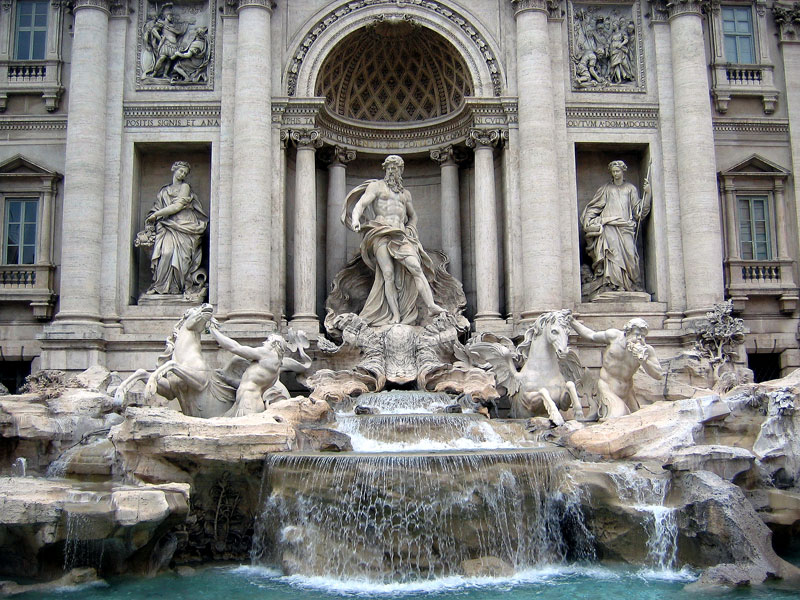

In [ ]:
#loading the first image (img1)
cv2_imshow(img1)

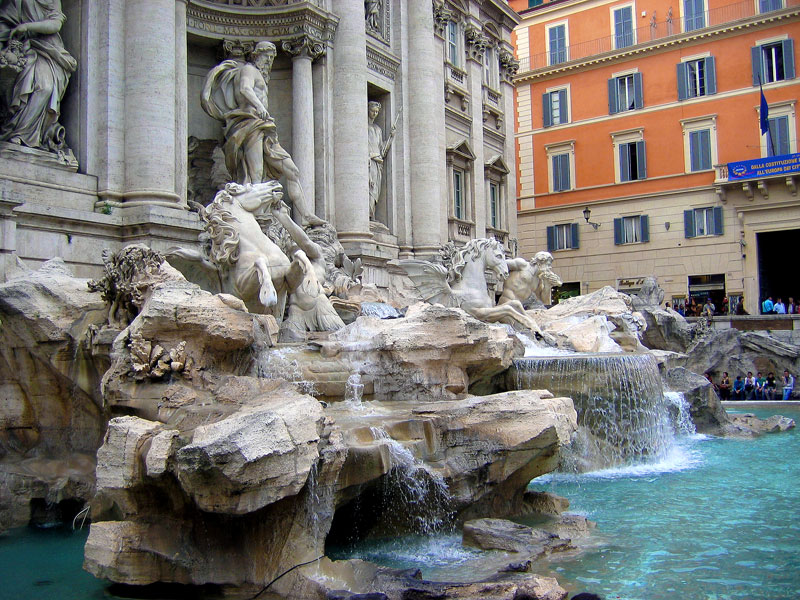

In [ ]:
#loading second image
cv2_imshow(img2)

In [ ]:
#finding the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)

In [ ]:
#finding matches using k nearest neighbors
bf = cv2.BFMatcher()
matches = bf.knnMatch(des1, des2, k=2)

In [ ]:
#apply ratio to threshold the best matches.
good = []
for m, n in matches:
  if m.distance < 0.75 * n.distance:
    good.append([m])

In [ ]:
#drawing the matches in image
img3 = cv2.drawMatchesKnn(
    img1, kp1, img2, kp2, good, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS
)

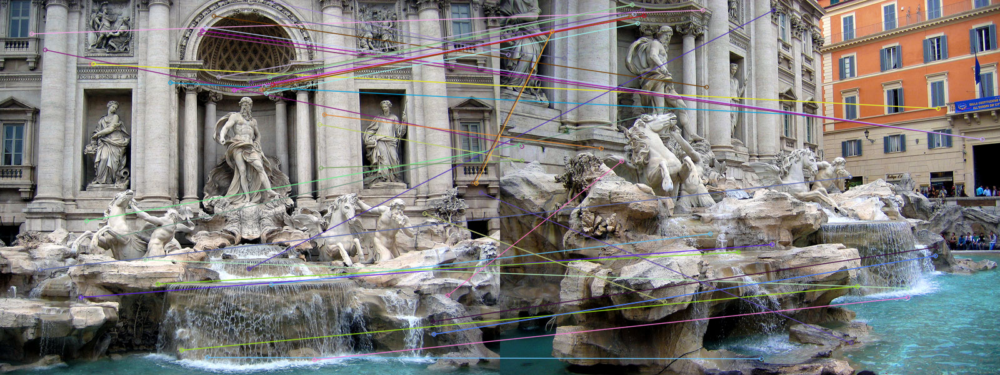

In [ ]:
cv2_imshow(img3)

### Brute-Force with ORB (binary) descriptors

ORB is a fusion of FAST keypoint detector and BRIEF descriptor with some added features to improve the performance.

In [ ]:
#loading orb descriptor
orb = cv2.ORB_create()

In [ ]:
#loading apollo_11 mission rocket images for ORB
img1 = cv2.imread("/content/drive/MyDrive/ComputerVisionTutorial/ImagesToPractise/apollo_11.jpg")
img2 = cv2.imread("/content/drive/MyDrive/ComputerVisionTutorial/ImagesToPractise/apollo_11_2.jpg")

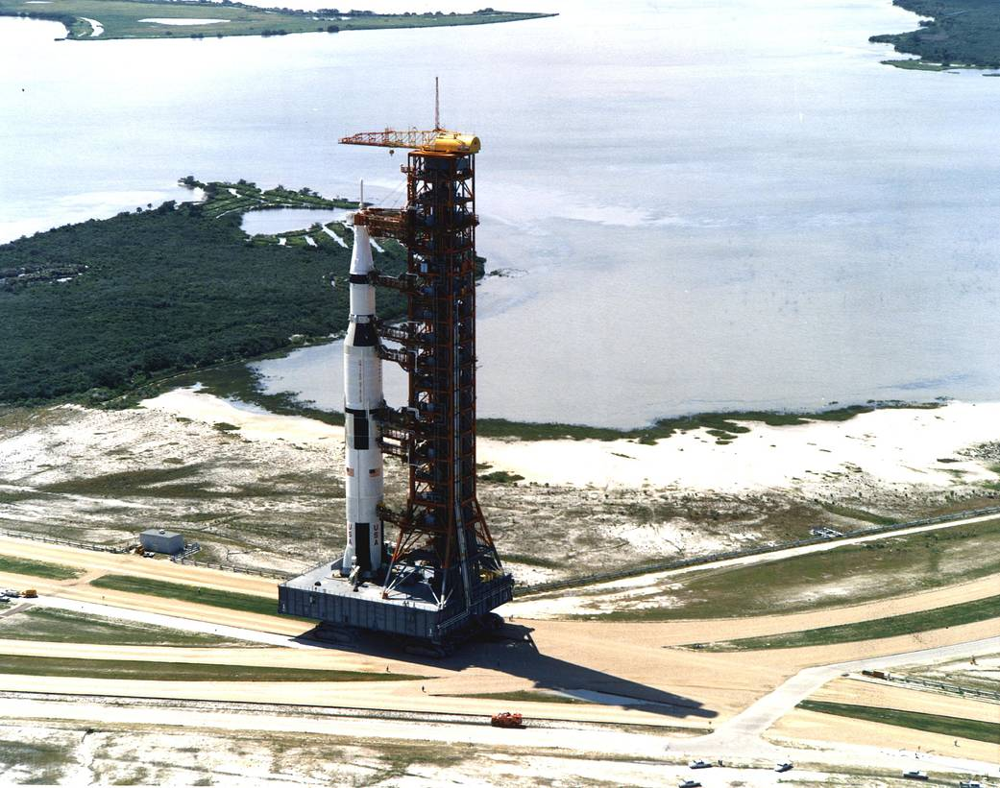

In [ ]:
cv2_imshow(img1)

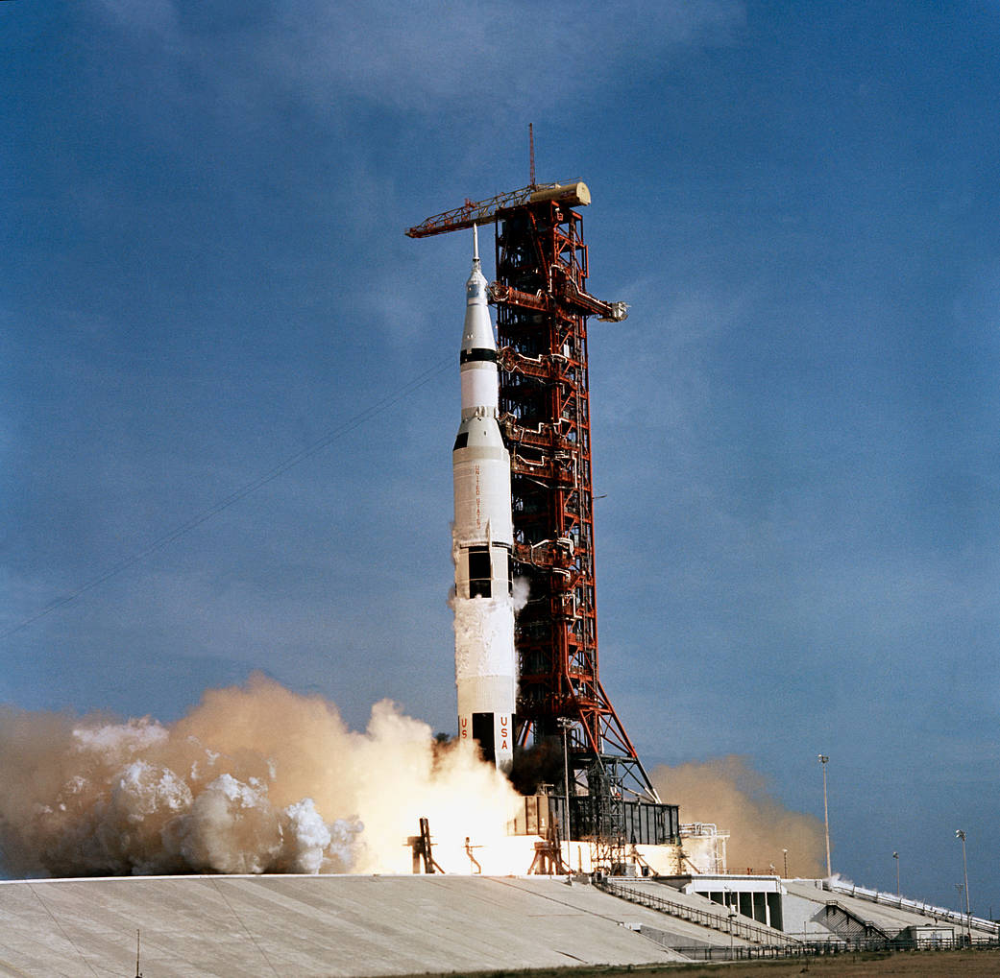

In [ ]:
cv2_imshow(img2)

In [ ]:
#finding keypoints and descriptors
kp1, des1 = orb.detectAndCompute(img1, None)
kp2, des2 = orb.detectAndCompute(img2, None)

**Note**: ORB is a binary descriptor, so using Hamming Distance to find matches, which is a measure of the difference between two strings of equal length

In [ ]:
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

In [ ]:
matches = bf.match(des1, des2)

In [ ]:
#sorting the order of their distance
matches = sorted(matches, key=lambda x: x.distance)

In [ ]:
#drawing the first n matches
img3 = cv2.drawMatches(img1, kp1, img2, kp2, matches[:], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

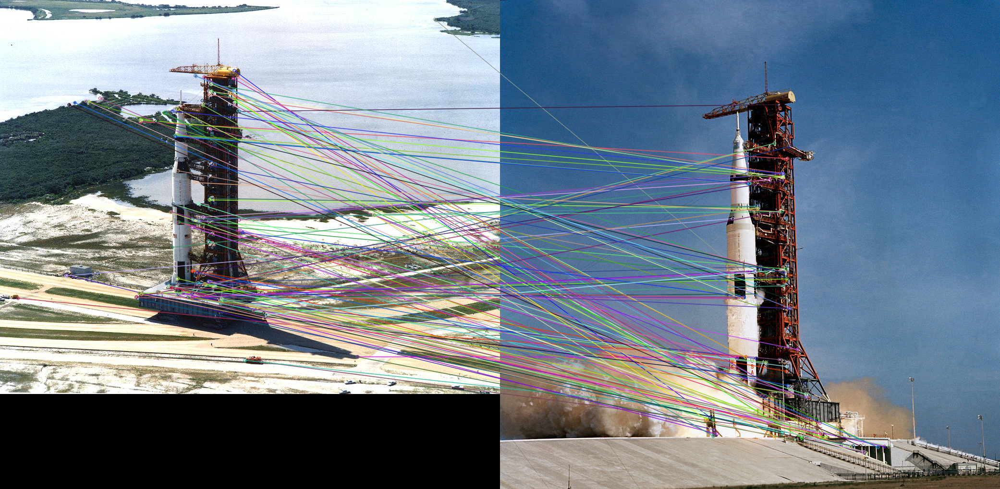

In [ ]:
cv2_imshow(img3)

### Fast Library for Approximate Nearest Neighbors (FLANN)

This method used helps time consuming when it comes to Brute-Force method

**Note**

The below FLANN for sift/surf

In [ ]:
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)

**Note**

The below FLANN for ORB

In [ ]:
FLANN_INDEX_LSH = 6
index_params = dict(
    algorithm=FLANN_INDEX_LSH,
    table_number=12,
    key_size=20,
    multi_probe_level=2
)

**Note**

The below code specifying the maximum leaf to visit

In [ ]:
search_params = dict(checks=50)

In [ ]:
#initiating the SIFT detector
sift = cv2.SIFT_create()

In [ ]:
#reading images
img1 = cv2.imread("/content/drive/MyDrive/ComputerVisionTutorial/ImagesToPractise/chernobyl.jpg")
img2 = cv2.imread("/content/drive/MyDrive/ComputerVisionTutorial/ImagesToPractise/chernobyl2.jpg")

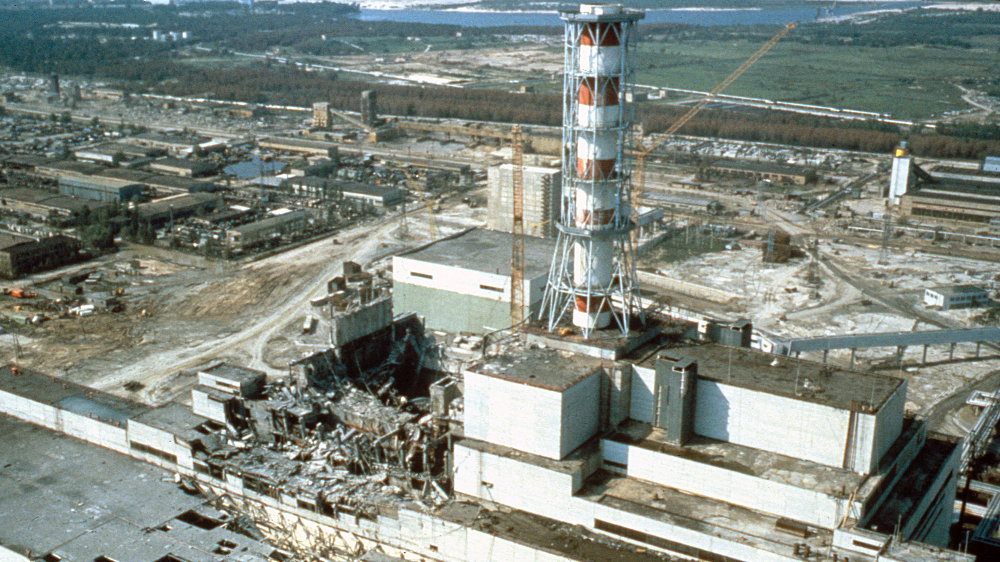

In [ ]:
cv2_imshow(img1)

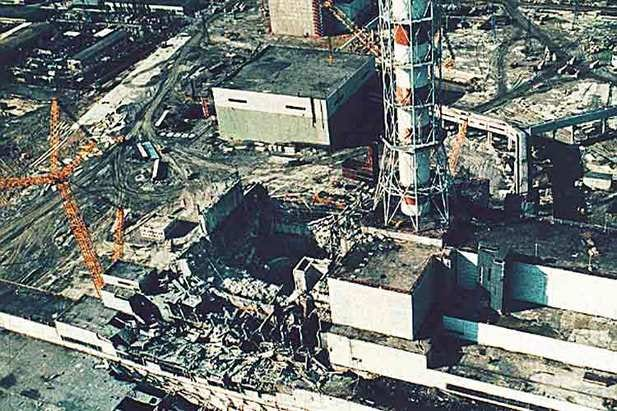

In [ ]:
cv2_imshow(img2)

In [ ]:
#finding keypoints
kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)

In [ ]:
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)
matches = flann.knnMatch(des1, des2, k=2)

In [ ]:
matches_mask = [[0, 0] for i in range(len(matches))]

In [ ]:
for i, (m, n) in enumerate(matches):
  if m.distance < 0.7 * n.distance:
    matches_mask[i] = [1, 0]

In [ ]:
draw_params = dict(
    matchColor=(0, 255, 0),
    singlePointColor=(0, 0, 255),
    matchesMask=matches_mask,
    flags=cv2.DrawMatchesFlags_DEFAULT
)

img3 = cv2.drawMatchesKnn(img1, kp1, img2, kp2, matches, None, **draw_params)

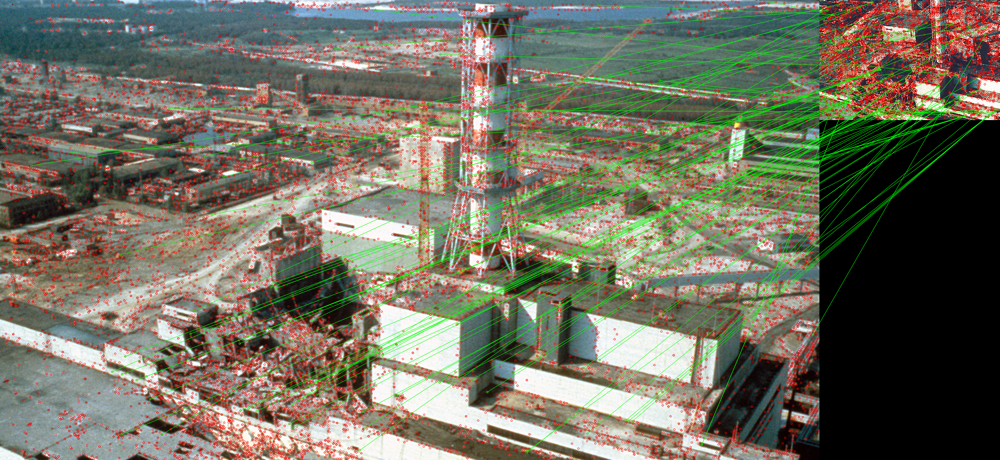

In [ ]:
cv2_imshow(img3)

### Local feature matching with transformers (LoFTR)

As LoFTR matches features, it assigns a similarity score to indicate how well the features align. Higher scores mean better matches. Using **kornia** to find matching features in two images using LoFTR.

In [33]:
#installing kornia
!pip install kornia kornia-rs kornia_moons opencv-python --upgrade

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl.metadata (1.8 kB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinu

In [35]:
import cv2
import kornia as K
import kornia.feature as KF
import matplotlib.pyplot as plt
import numpy as np
import torch
from kornia_moons.viz import draw_LAF_matches
from kornia.feature import LoFTR

In [36]:
#load and resize the images
img1 = K.io.load_image("/content/drive/MyDrive/ComputerVisionTutorial/ImagesToPractise/chernobyl2.jpg", K.io.ImageLoadType.RGB32)[None, ...]
img2 = K.io.load_image("/content/drive/MyDrive/ComputerVisionTutorial/ImagesToPractise/chernobyl.jpg", K.io.ImageLoadType.RGB32)[None, ...]

img1 = K.geometry.resize(img1, (512, 512), antialias=True)
img2 = K.geometry.resize(img2, (512, 512), antialias=True)

In [37]:
#indicate the image is an "indoor" or "outdoor"
matches = LoFTR(pretrained="outdoor")

Downloading: "http://cmp.felk.cvut.cz/~mishkdmy/models/loftr_outdoor.ckpt" to /root/.cache/torch/hub/checkpoints/loftr_outdoor.ckpt
100%|██████████| 44.2M/44.2M [00:02<00:00, 19.2MB/s]


In [38]:
#LoFTR only works in "grayscale" images so we need to convert the images to grayscale
input_dict = {
    "image0":K.color.rgb_to_grayscale(img1),
    "image1":K.color.rgb_to_grayscale(img2)
}

In [39]:
with torch.inference_mode():
  correspondences = matches(input_dict)

Clean up the correspondences using Random Sample Consenusus (RANSAC). This helps to deal with noise or outliers in the data.

In [40]:
mkpts0 = correspondences["keypoints0"].cpu().numpy()
mkpts1 = correspondences["keypoints1"].cpu().numpy()
Fm, inliers = cv2.findFundamentalMat(mkpts0, mkpts1, cv2.USAC_MAGSAC, 0.5, 0.999, 100000)
inliers = inliers > 0

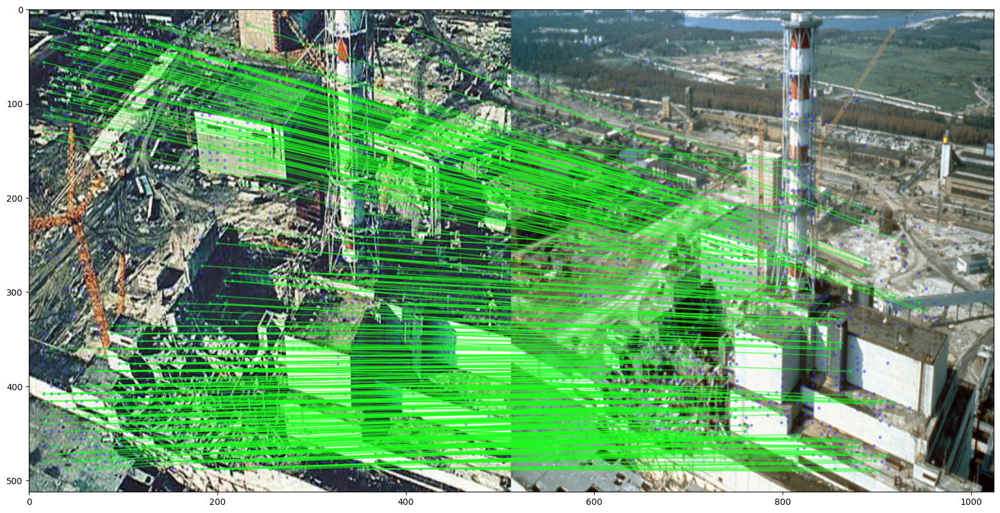

In [41]:
#now we visualizing the matches
draw_LAF_matches(
    KF.laf_from_center_scale_ori(
        torch.from_numpy(mkpts0).view(1, -1, 2),
        torch.ones(mkpts0.shape[0]).view(1, -1, 1, 1),
        torch.ones(mkpts0.shape[0]).view(1, -1, 1),
    ),
    KF.laf_from_center_scale_ori(
        torch.from_numpy(mkpts1).view(1, -1, 2),
        torch.ones(mkpts1.shape[0]).view(1, -1, 1, 1),
        torch.ones(mkpts1.shape[0]).view(1, -1, 1),
    ),
    torch.arange(mkpts0.shape[0]).view(-1, 1).repeat(1, 2),
    K.tensor_to_image(img1),
    K.tensor_to_image(img2),
    inliers,
    draw_dict={
        "inlier_color":(0.1, 1, 0.1, 0.5),
        "tentative_color":None,
        "feature_color":(0.2, 0.2, 1, 0.5),
        "vertical":False,
    }
)